In [ ]:
# Investigating how accuracy improves at different distances

In [1]:
import rtde_control
import rtde_receive
import numpy as np
import spatialmath as sm
import time
robotIP = "192.168.0.4"
con = rtde_control.RTDEControlInterface(robotIP)
rec = rtde_receive.RTDEReceiveInterface(robotIP)

from magpie import realsense_wrapper as real
rsc = real.RealSense()
rsc.initConnection()

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [2]:
from block_task.Motor_Code import Motors
import block_task.UR5_Interface as ur
servoPort = "/dev/ttyACM0"
gripperController = Motors(servoPort)
gripperController.torquelimit(600) # used to be 600
gripperController.speedlimit(100)
ur = ur.UR5_Interface()
ur.gripperController = gripperController

Succeeded to open the port
Succeeded to change the baudrate
Moving speed of dxl ID: 1 set to 100 
Moving speed of dxl ID: 2 set to 100 
Moving speed of dxl ID: 1 set to 100 
Moving speed of dxl ID: 2 set to 100 


In [3]:
try:
    ur.c = con
    ur.r = rec
    ur.gripperController = gripperController
except Exception as e:
    raise(e)
else:
    print("UR5 + Gripper Interface Established")

UR5 + Gripper Interface Established


In [4]:

# np.save("homepose",np.array(ur.getPose()))

pass


In [5]:
# home_pose = np.load("homepose.npy")
# home_pose = sm.SE3(home_pose)
# ur.moveL(home_pose)

In [6]:
from magpie.perception.label_owlvit import LabelOWLViT
path = "google/owlvit-base-patch32"
label_vit = LabelOWLViT( path )

2024-05-09 15:43:28.370540: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-09 15:43:28.370573: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-09 15:43:28.370598: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-05-09 15:43:28.376513: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-05-09 15:43:29.081125: W tensorflow/compiler/

In [7]:
from magpie.perception.mask_sam import MaskSAM
ckpt = "/home/streck/work/owlvit_segment_anything/sam_vit_h_4b8939.pth"
mask_sam = MaskSAM(ckpt)

PermissionError: [Errno 13] Permission denied: '/home/streck/work/owlvit_segment_anything/sam_vit_h_4b8939.pth'

Incrementing robot forward
[]
[]
Incrementing robot forward
[]
[]
Incrementing robot forward
[]
[]
Incrementing robot forward
['yellowBlock' 'yellowBlock']
[0.14610276, 0.14108972]
Incrementing robot forward
['yellowBlock' 'yellowBlock']
[0.14816903, 0.15020458]
Incrementing robot forward
['yellowBlock' 'yellowBlock' 'yellowBlock']
[0.16043821, 0.15698424, 0.13951863]
Incrementing robot forward
['yellowBlock' 'yellowBlock']
[0.12258461, 0.13499439]
Incrementing robot forward
['yellowBlock' 'yellowBlock' 'yellowBlock']
[0.11353001, 0.1309794, 0.12752314]
Incrementing robot forward
['yellowBlock' 'yellowBlock' 'yellowBlock']
[0.10588689, 0.14138824, 0.11373773]
Incrementing robot forward
['yellowBlock' 'yellowBlock']
[0.11286435, 0.14921294]
Incrementing robot forward
['yellowBlock' 'yellowBlock']
[0.1061321, 0.15223381]
Incrementing robot forward
['yellowBlock' 'yellowBlock']
[0.10990109, 0.14510925]
Incrementing robot forward
['yellowBlock' 'yellowBlock']
[0.13163832, 0.17509747]
Incre

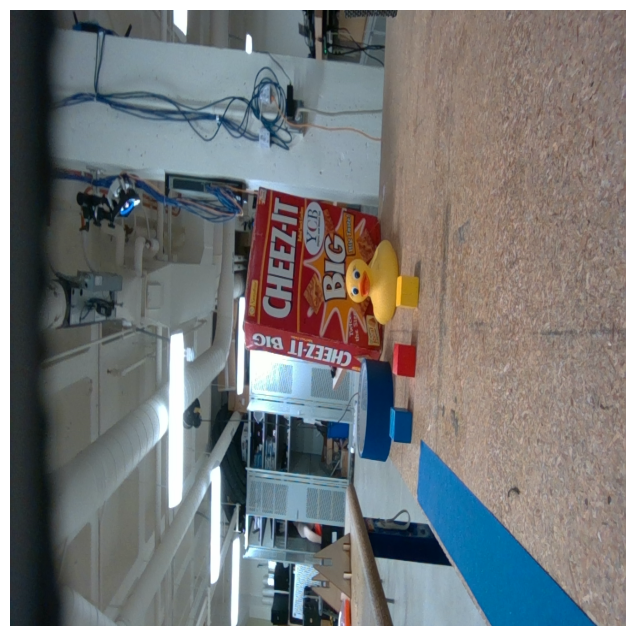

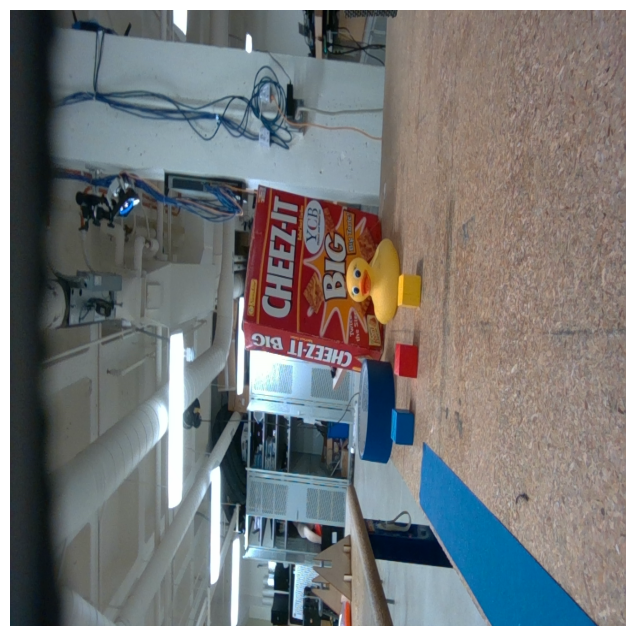

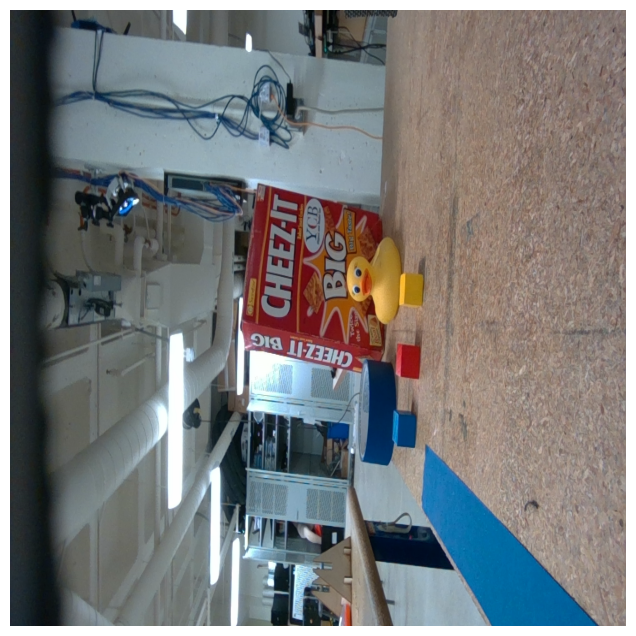

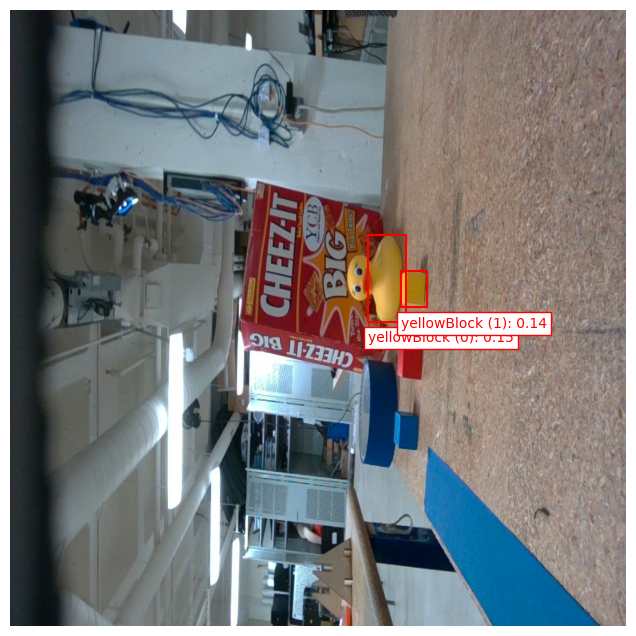

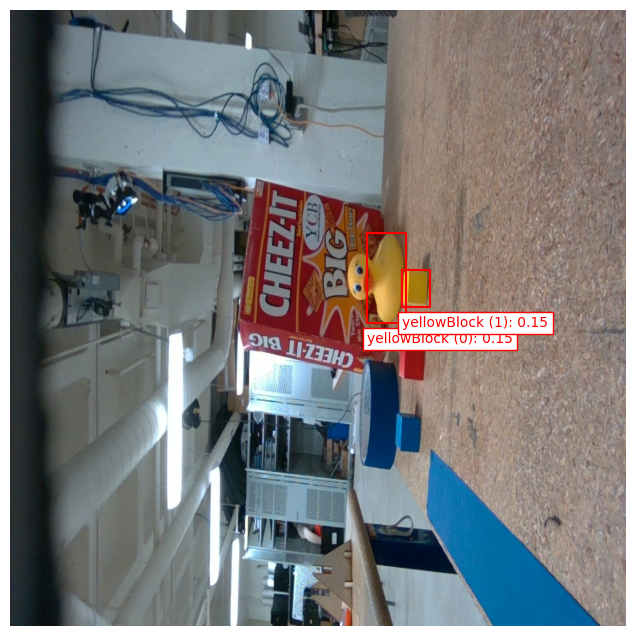

...

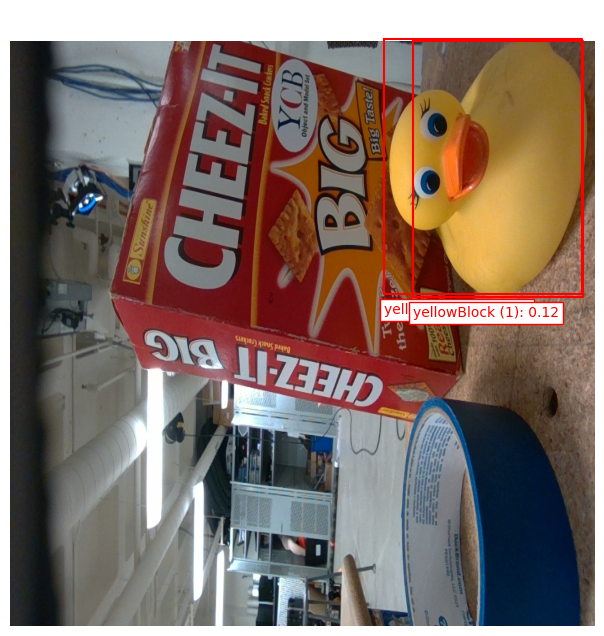

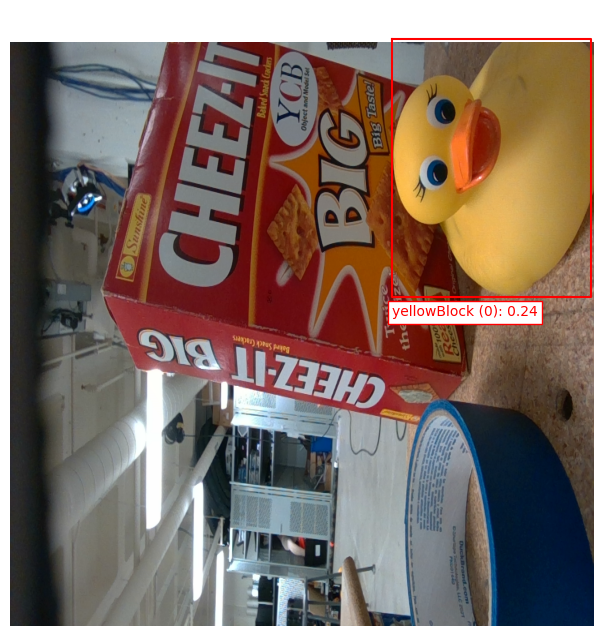

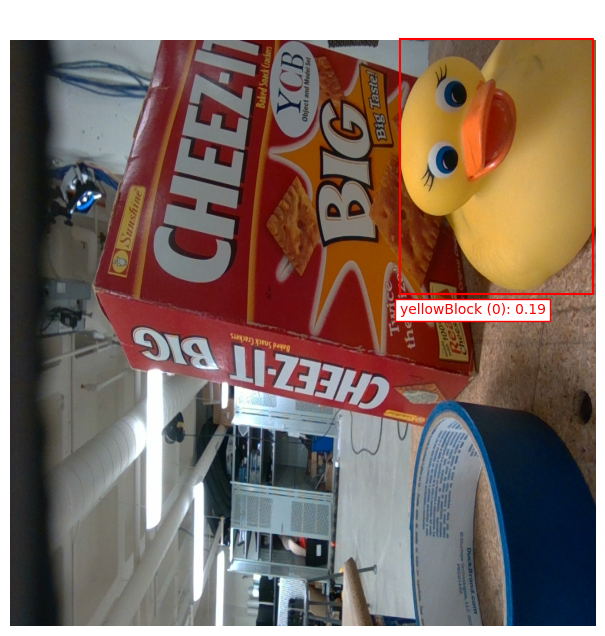

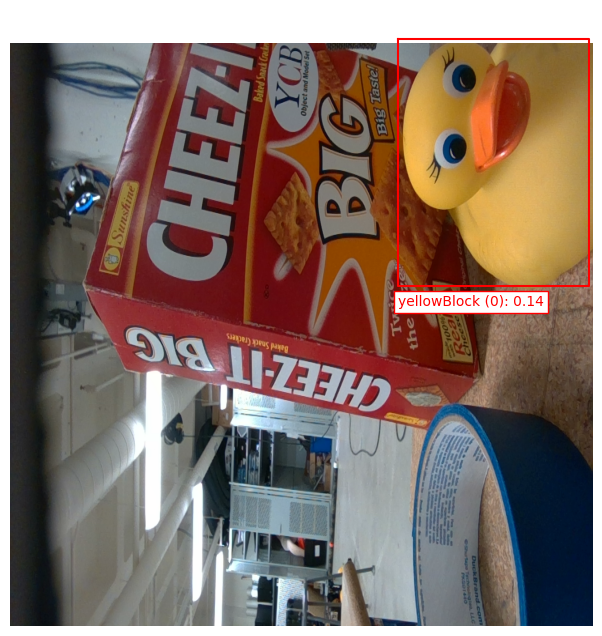

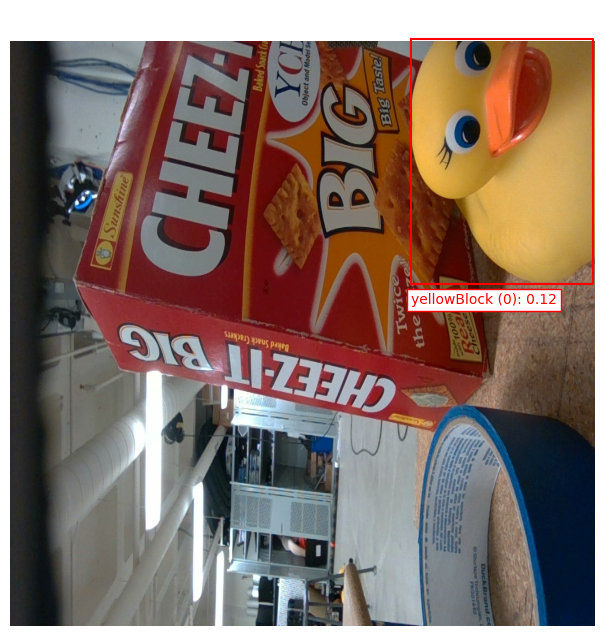

In [29]:
# Test move forward
# ur.moveL(home_pose)
sleep_rate = 0.75
increm = 7/1000 # 7mm

queries = ["a photo of a yellow cube"]
abbrevq = ["yellowBlock"]

label_vit.set_threshold(0.1)

confidences = []
for x in range(0,50):
    initPose = np.array(ur.getPose())

    dX, dY, dZ = 0, -1*increm, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)

    print('Incrementing robot forward')
    ur.moveL(sm.SE3(goalPose))
    time.sleep(sleep_rate)
    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    bboxes, uboxes, scores = label_vit.label(image, queries, abbrevq, x,plot=True)
    print(label_vit.labels)
    print(scores)


In [ ]:
#np.save("homepose-test-2",np.array(ur.getPose()))
pass
initPose = np.array(ur.getPose())
increm

dX, dY, dZ = 0, -, 0 # may need to switch increm to dY
goalPose = initPose
goalPose[1][3] += dY 
goalPose = sm.SE3(goalPose)

print('Incrementing robot forward')
ur.moveL(sm.SE3(goalPose))

In [7]:
home_pose = np.load("homepose-test-2.npy")
home_pose = sm.SE3(home_pose)
ur.moveL(home_pose)
import time


In [9]:
#rotate around object
#jAngle = ur.getJointAngles()
#jAngle[4] += 0.1
#ur.moveJ(jAngle)
ur.moveL(sm.SE3(home_pose))

incremx = 25/1000 
incremy = 15/1000
angle = 5/100

queries = ["a photo of a red cube"]
abbrevq = ["redBlock"]

label_vit.set_threshold(0.1)
home_pose = np.array(ur.getPose())
home_pose = sm.SE3(home_pose)
home_angle = ur.getJointAngles()
queries = ["a photo of a red cube"]
abbrevq = ["redBlock-angle"]

label_vit.set_threshold(0.1)
for x in range(0,5):
    time.sleep(1)
    initPose = np.array(ur.getPose())

    dX, dY, dZ = incremx, -incremy, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[0][3] += dX
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)



    print('Incrementing robot')
    ur.moveL(sm.SE3(goalPose))
    time.sleep(sleep_rate)
    jAngles = ur.getJointAngles()
    jAngles[4] += angle # scalar is a weight for angle of rotation
    ur.moveJ(jAngles)
    time.sleep(sleep_rate)
    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    bboxes, uboxes, scores = label_vit.label(image, queries, abbrevq, x, plot=True)
    print(label_vit.labels)
    print(scores)

ur.moveL(sm.SE3(home_pose))
time.sleep(sleep_rate)
ur.moveJ(home_angle)
time.sleep(sleep_rate)
for x in range(0,5): # does the opposite of first loop
    time.sleep(1)
    initPose = np.array(ur.getPose())

    dX, dY, dZ = -incremx, -incremy, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[0][3] += dX
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)



    print('Incrementing robot')
    time.sleep(sleep_rate)
    ur.moveL(sm.SE3(goalPose))
    time.sleep(sleep_rate)
    jAngles = ur.getJointAngles()
    jAngles[4] -= angle # scalar is a weight for angle of rotation
    ur.moveJ(jAngles)

    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    bboxes, uboxes, scores = label_vit.label(image, queries, abbrevq, -x,plot=True) # conditional to not repeat angles when readjusting
    print(label_vit.labels)
    print(scores)

ur.moveL(sm.SE3(home_pose))
time.sleep(sleep_rate)
ur.moveJ(home_angle)

NameError: name 'label_vit' is not defined

In [8]:
import time
incremx = 25/1000 
incremy = 15/1000
angle = 5/100
for x in range(0,3): # does the opposite of first loop
    time.sleep(1)
    initPose = np.array(ur.getPose())

    dX, dY, dZ = increm, increm, 0 # may need to switch increm to dY
    goalPose = initPose
    goalPose[0][3] += dX
    goalPose[1][3] += dY 
    goalPose = sm.SE3(goalPose)

    jAngles = ur.getJointAngles()
    jAngles[4] += increm*25 # scalar is a weight for angle of rotation

    print('Incrementing robot forward')
    ur.moveL(sm.SE3(goalPose))
    ur.moveJ(jAngles)

    p, rgbd_image = rsc.getPCD()
    image = np.array(rgbd_image.color)
    if x < 25: label_vit.label(image, queries, abbrevq, plot=True) # conditional to not repeat angles when readjusting
    #print(label_vit.labels)
    #print(scores)

NameError: name 'increm' is not defined

In [9]:
ur.moveL(sm.SE3(initPose))

In [ ]:
#p, rgbd_image = rsc.getPCD()

#queries = ["a photo of a red cube"]

#abbrevq = ["redBlock"]
#label_vit.set_threshold(0.03)
#bboxes, uboxes = label_vit.label(image2, queries, abbrevq, plot=True)

In [4]:
# gripperController.openGripper()
# gripperController.disconnect()
# ur.c.disconnect()
# ur.r.disconnect()
real.disconnect()

AttributeError: module 'magpie.realsense_wrapper' has no attribute 'disconnect'